In [122]:
import tensorflow
import seaborn as sns
import matplotlib.pyplot as plt
import scipy
from BorutaShap import BorutaShap
from xgboost import XGBRegressor
from sklearn.model_selection import LeaveOneOut, KFold, GridSearchCV, cross_val_score
from sklearn.preprocessing import RobustScaler
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.svm import SVR
from lightgbm import LGBMRegressor
from catboost import CatBoostRegressor
from sklearn.neural_network import MLPRegressor
import numpy as np
from sklearn.inspection import PartialDependenceDisplay
import pandas as pd
import warnings
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import RFE
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_squared_error
from sklearn.model_selection import LeaveOneOut, KFold
from sklearn.preprocessing import RobustScaler, StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.model_selection import cross_val_predict
from sklearn.feature_selection import RFECV
from sklearn.linear_model import LinearRegression

In [123]:
warnings.filterwarnings('ignore')

df = pd.read_csv('data.csv')
df.drop('Sl. No.', axis=1, inplace=True)

X = df.drop('Fatigue', axis = 1)
y = df.Fatigue

index_carburizing = -48  # The last 48 entries are carburizing steels
index_spring = -48-18    # The previous 18 before the last 48 entries are spring steels

X_carburizing = X.iloc[index_carburizing:]
y_carburizing = y.iloc[index_carburizing:]
X_spring = X.iloc[index_spring:index_carburizing]
y_spring = y.iloc[index_spring:index_carburizing]
X_carbon_low_alloy = X.iloc[:index_spring]
# print(X_carbon_low_alloy)
y_carbon_low_alloy = y.iloc[:index_spring]

X_train_carburizing, X_test_carburizing, y_train_carburizing, y_test_carburizing = train_test_split(
    X_carburizing, y_carburizing, test_size=0.2, random_state=44)

X_train_spring, X_test_spring, y_train_spring, y_test_spring = train_test_split(
    X_spring, y_spring, test_size=0.2, random_state=44)

X_train_carbon_low_alloy, X_test_carbon_low_alloy, y_train_carbon_low_alloy, y_test_carbon_low_alloy = train_test_split(
    X_carbon_low_alloy, y_carbon_low_alloy, test_size=0.2, random_state=44)

X_train = pd.concat([X_train_carburizing, X_train_spring, X_train_carbon_low_alloy], ignore_index=False)
X_test = pd.concat([X_test_carburizing, X_test_spring, X_test_carbon_low_alloy], ignore_index=False)
y_train = pd.concat([y_train_carburizing, y_train_spring, y_train_carbon_low_alloy], ignore_index=False)
y_test = pd.concat([y_test_carburizing, y_test_spring, y_test_carbon_low_alloy], ignore_index=False)

model = SVR(kernel='linear')
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)

from sklearn.feature_selection import RFECV

rfecv = RFECV(
    estimator=model,
    min_features_to_select=5,
    step=1,
    n_jobs=-1,
    scoring="r2",
    cv=5,
)

rfecv.fit(X_train_scaled, y_train)
print(X_train.columns[rfecv.support_])
selected_features_RFE = X_train.columns[rfecv.support_]
print(len(X_train.columns[rfecv.support_]))
X_train = X_train[selected_features_RFE]
X_test = X_test[selected_features_RFE]

Index(['THQCr', 'CT', 'Ct', 'DT', 'QmT', 'TT', 'Tt', 'C', 'Si', 'Ni', 'Cr',
       'Mo'],
      dtype='object')
12


In [83]:
# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state= 42)
# lm = LinearRegression()
# lr_model = lm.fit(X_train, y_train)
# cross_val_score1=cross_val_score(lr_model, X_train, y_train, cv=KFold(), scoring='r2').mean() #verified score value for train model
# print('Verified R2 value for Training model: ' + str(cross_val_score1))

# cross_val_score2=cross_val_score(lr_model, X_test, y_test, cv=10, scoring='r2').mean() #verified score value for test model
# print('Verified R2 value for Testing Model: ' + str(cross_val_score2))

In [154]:
from sklearn.neighbors import KNeighborsRegressor
model = KNeighborsRegressor()
scalar = RobustScaler()
cv = LeaveOneOut()

# pipeline = Pipeline([ ('estimator', model)])

y_pred_cv = cross_val_predict(model, X_train, y_train, cv=cv)
r2_cv = r2_score(y_train, y_pred_cv)
print('R^2 CV:', r2_cv)


model.fit(X_train, y_train)
y_pred = model.predict(X_test)
r2 = r2_score(y_test, y_pred)
MSE = mean_squared_error(y_test, y_pred)

print('Test R^2 :', r2)
print('Test MSE :', MSE)


R^2 CV: 0.9532031228509138
Test R^2 : 0.9491764957474033
Test MSE : 2011.3029213483146


In [155]:

k = {'n_neighbors': np.arange(1,30,1)} 


cv_model = GridSearchCV(model, k, cv = cv, scoring='neg_mean_squared_error', return_train_score=True) 
cv_model.fit(X_train, y_train)
cv_results = cv_model.cv_results_
best_score = -np.max(cv_results['mean_test_score'])  

print("Best case MSE", best_score)
print("Best number of neighbors:", cv_model.best_params_['n_neighbors'])

knn_model_tuned = KNeighborsRegressor(n_neighbors = cv_model.best_params_["n_neighbors"])

predictions_RFE = cross_val_predict(knn_model_tuned, X_train, y_train, cv=cv)
r2_RFE = r2_score(y_train, predictions_RFE)
print('R^2 RFE:', r2_RFE)

knn_model_tuned.fit(X_train, y_train)
y_pred = knn_model_tuned.predict(X_test)
r2_test= r2_score(y_test, y_pred)
MSE_test= mean_squared_error(y_test, y_pred)

print('Test R^2 with reduced feature set:', r2_test)
print('Test MSE with reduced feature set:', MSE_test)

ranges = {
    'Carbon and Low Alloy Steels': (0, 370),
    'Spring Steels': (371, 388),
    'Carburizing Steels': (389, 436)
}

for label, (start_idx, end_idx) in ranges.items():
    mask = y_test.index.isin(range(start_idx, end_idx+1))
    predictions_subset = y_pred[mask]
    actual_subset = y_test[mask]
    r2_subset = mean_squared_error(actual_subset, predictions_subset)
    print(f'MSE for {label}: {r2_subset}')

Best case MSE 1567.0527586206897
Best number of neighbors: 5
R^2 RFE: 0.9532031228509138
Test R^2 with reduced feature set: 0.9491764957474033
Test MSE with reduced feature set: 2011.3029213483146
MSE for Carbon and Low Alloy Steels: 547.5840000000001
MSE for Spring Steels: 9706.519999999993
MSE for Carburizing Steels: 9911.108000000002


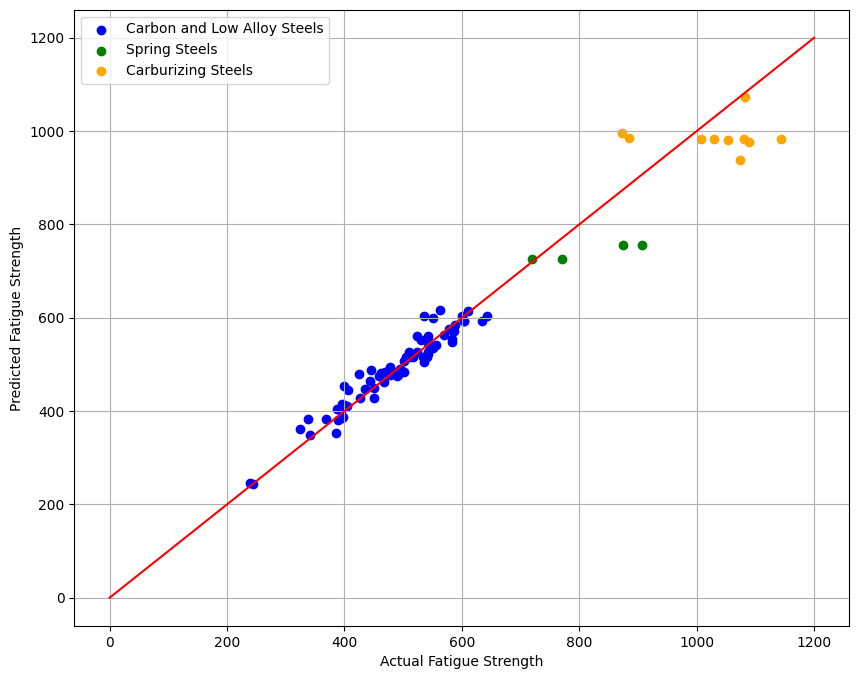

In [ ]:
plt.figure(figsize=(10, 8))

for index_range, color, label in [([0, 370], 'blue', 'Carbon and Low Alloy Steels'), 
                                  ([371, 388], 'green', 'Spring Steels'), 
                                  ([389, 436], 'orange', 'Carburizing Steels')]:
    mask = y_test.index.isin(range(index_range[0], index_range[1]+1))
    plt.scatter(y_test[mask], y_pred[mask], color=color, label=label)

plt.xlabel('Actual Fatigue Strength')
plt.ylabel('Predicted Fatigue Strength')
plt.legend()
plt.grid(True)
x = np.linspace(0, 1200, 1000)
plt.plot(x, x, color='red')
plt.show()

In [115]:
model = XGBRegressor()
scalar = RobustScaler()
cv = LeaveOneOut()

# model = Pipeline([ ('transformer', scalar), ('estimator', model)])

y_pred_cv = cross_val_predict(model, X_train, y_train, cv=cv)
r2_cv = r2_score(y_train, y_pred_cv)
print('R^2 CV:', r2_cv)

model.fit(X_train, y_train)
y_pred = model.predict(X_test)
r2 = r2_score(y_test, y_pred)
MSE = mean_squared_error(y_test, y_pred)

print('Test R^2 :', r2)
print('Test MSE :', MSE)

R^2 CV: 0.9744801715082761
Test R^2 : 0.9731180999903412
Test MSE : 1063.8314853714114


In [ ]:
params = {
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 5, 8],
    'n_estimators': [100, 500, 1000],
    'subsample': [0.8]
}
cv_model = GridSearchCV(model, params, scoring='neg_mean_squared_error', cv = cv, n_jobs = -1, verbose = 2)
cv_model.fit(X_train, y_train)

cv_results = cv_model.cv_results_
best_score = -np.max(cv_results['mean_test_score'])

print("Best case MSE", best_score)
print("Best params:", cv_model.best_params_)


Fitting 348 folds for each of 27 candidates, totalling 9396 fits
Best case MSE 638.0550991924293
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1000, 'subsample': 0.8}


In [151]:
xgb_model_tuned = XGBRegressor(learning_rate = 0.1,  
                               max_depth = 3, 
                               n_estimators = 1000, 
                               subsample = 0.8)


predictions_RFE = cross_val_predict(xgb_model_tuned, X_train, y_train, cv=cv)
r2_RFE = r2_score(y_train, predictions_RFE)
print('R^2 RFE:', r2_RFE)

xgb_model_tuned.fit(X_train, y_train)
y_pred = xgb_model_tuned.predict(X_test)
r2_test= r2_score(y_test, y_pred)
MSE_test= mean_squared_error(y_test, y_pred)

print('Test R^2 with reduced feature set:', r2_test)
print('Test MSE with reduced feature set:', MSE_test)


for label, (start_idx, end_idx) in ranges.items():
    mask = y_test.index.isin(range(start_idx, end_idx+1))
    predictions_subset = y_pred[mask]
    actual_subset = y_test[mask]
    r2_subset = mean_squared_error(actual_subset, predictions_subset)
    print(f'MSE for {label}: {r2_subset}')

R^2 RFE: 0.9809457684644021
Test R^2 with reduced feature set: 0.9730587479323659
Test MSE with reduced feature set: 1066.180299553926
MSE for Carbon and Low Alloy Steels: 300.2956737404441
MSE for Spring Steels: 15894.45279067941
MSE for Carburizing Steels: 879.0059967048467


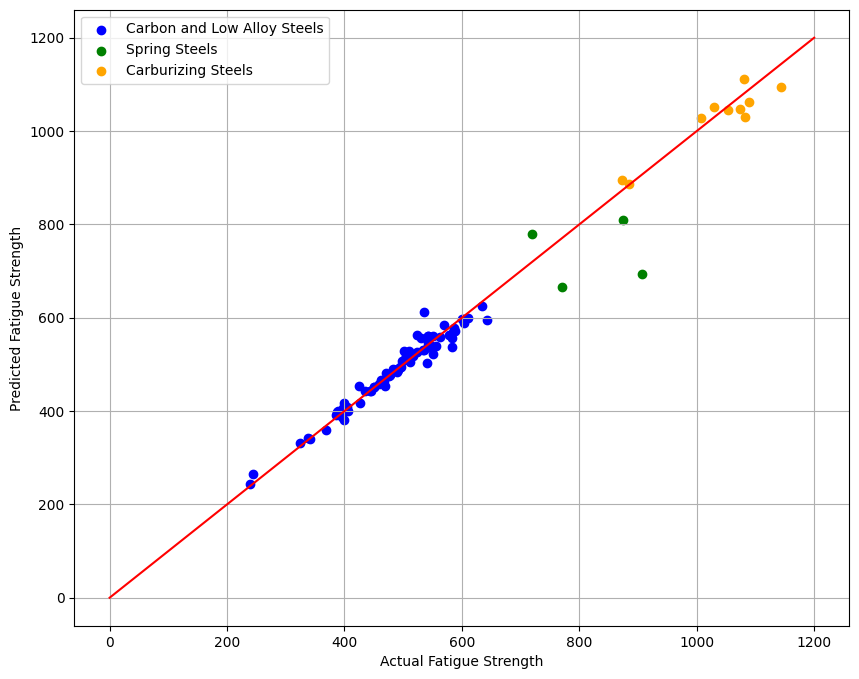

In [152]:
plt.figure(figsize=(10, 8))

for index_range, color, label in [([0, 370], 'blue', 'Carbon and Low Alloy Steels'), 
                                  ([371, 388], 'green', 'Spring Steels'), 
                                  ([389, 436], 'orange', 'Carburizing Steels')]:
    mask = y_test.index.isin(range(index_range[0], index_range[1]+1))
    plt.scatter(y_test[mask], y_pred[mask], color=color, label=label)

plt.xlabel('Actual Fatigue Strength')
plt.ylabel('Predicted Fatigue Strength')
plt.legend()
plt.grid(True)
x = np.linspace(0, 1200, 1000)
plt.plot(x, x, color='red')
plt.show()

In [ ]:
# warnings.filterwarnings('ignore')
# warnings.filterwarnings("ignore", category=UserWarning, message=".*No further splits with positive gain, best gain: -inf*")
# warnings.filterwarnings("ignore", category=UserWarning, message=".*Auto-choosing row-wise multi-threading.*")

model = LGBMRegressor()
scalar = RobustScaler()
cv = LeaveOneOut()

# model = Pipeline([ ('transformer', scalar), ('estimator', model)])

y_pred_cv = cross_val_predict(model, X_train, y_train, cv=cv)
r2_cv = r2_score(y_train, y_pred_cv)
print('R^2 CV:', r2_cv)

model.fit(X_train, y_train)
y_pred = model.predict(X_test, num_iteration = model.best_iteration_)
r2 = r2_score(y_test, y_pred)
MSE = mean_squared_error(y_test, y_pred)

print('Test R^2 :', r2)
print('Test MSE :', MSE)

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000088 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 207
[LightGBM] [Info] Number of data points in the train set: 347, number of used features: 12
[LightGBM] [Info] Start training from score 548.878963
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: 

In [ ]:
params = {
    'colsample_bytree': [0.7, 0.8, 0.9], #[0.4, 0.5,0.6,0.9,1]
    'learning_rate': [0.01, 0.1, 0.5,1],
    'n_estimators': [20, 40, 100, 200], #, 500,1000
    'max_depth': [1,3,5,7,9] 
}

cv_model = GridSearchCV(model, params, scoring='neg_mean_squared_error', cv = cv, n_jobs = -1, verbose = 2)
cv_model.fit(X_train, y_train)

cv_results = cv_model.cv_results_
best_score = -np.max(cv_results['mean_test_score'])

print("Best case MSE", best_score)
print("Best params:", cv_model.best_params_)


Fitting 348 folds for each of 240 candidates, totalling 83520 fits
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.163882 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 208
[LightGBM] [Info] Number of data points in the train set: 348, number of used features: 12
[LightGBM] [Info] Start training from score 550.370690
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

In [237]:
LGBM_model_tuned = LGBMRegressor(learning_rate = 0.5, 
                                max_depth = 5, 
                                n_estimators = 200,
                                colsample_bytree = 0.7)
LGBM_model_tuned.fit(X_train, y_train)

predictions_RFE = cross_val_predict(LGBM_model_tuned, X_train, y_train, cv=cv)
r2_RFE = r2_score(y_train, predictions_RFE)
print('R^2 RFE:', r2_RFE)

y_pred = LGBM_model_tuned.predict(X_test)
r2_test= r2_score(y_test, y_pred)
MSE_test= mean_squared_error(y_test, y_pred)

print('Test R^2 with reduced feature set:', r2_test)
print('Test MSE with reduced feature set:', MSE_test)


for label, (start_idx, end_idx) in ranges.items():
    mask = y_test.index.isin(range(start_idx, end_idx+1))
    predictions_subset = y_pred[mask]
    actual_subset = y_test[mask]
    r2_subset = mean_squared_error(actual_subset, predictions_subset)
    print(f'MSE for {label}: {r2_subset}')

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000145 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 208
[LightGBM] [Info] Number of data points in the train set: 348, number of used features: 12
[LightGBM] [Info] Start training from score 550.370690
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No 

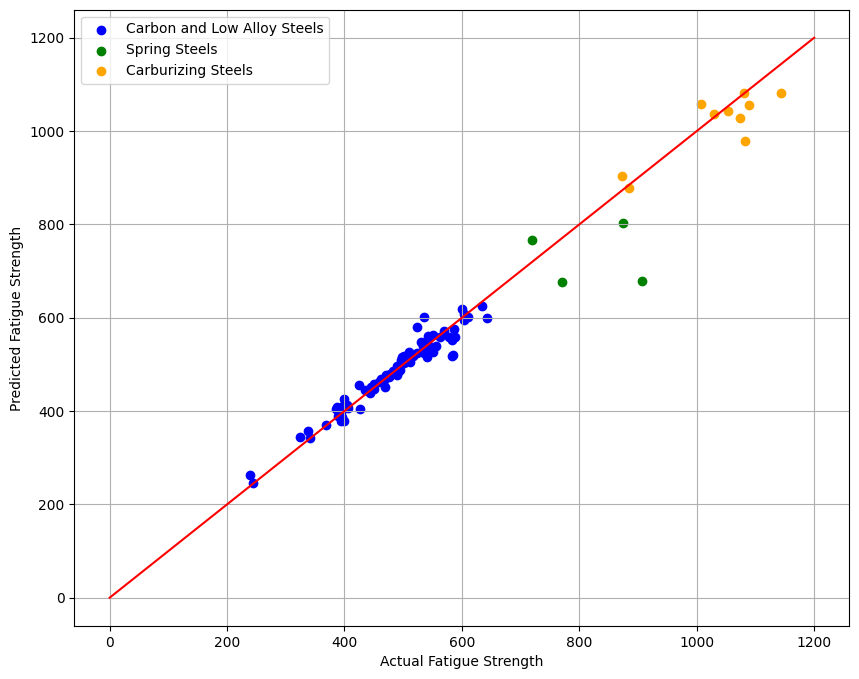

In [ ]:
plt.figure(figsize=(10, 8))

for index_range, color, label in [([0, 370], 'blue', 'Carbon and Low Alloy Steels'), 
                                  ([371, 388], 'green', 'Spring Steels'), 
                                  ([389, 436], 'orange', 'Carburizing Steels')]:
    mask = y_test.index.isin(range(index_range[0], index_range[1]+1))
    plt.scatter(y_test[mask], y_pred[mask], color=color, label=label)

plt.xlabel('Actual Fatigue Strength')
plt.ylabel('Predicted Fatigue Strength')
plt.legend()
plt.grid(True)
x = np.linspace(0, 1200, 1000)
plt.plot(x, x, color='red')
plt.show()

In [118]:
model = CatBoostRegressor()
scalar = RobustScaler()
cv = LeaveOneOut()

# model = Pipeline([ ('transformer', scalar), ('estimator', model)])

y_pred_cv = cross_val_predict(model, X_train, y_train, cv=5)
r2_cv = r2_score(y_train, y_pred_cv)
print('R^2 CV:', r2_cv)

model.fit(X_train, y_train)
y_pred = model.predict(X_test)
r2 = r2_score(y_test, y_pred)
MSE = mean_squared_error(y_test, y_pred)

print('Test R^2 :', r2)
print('Test MSE :', MSE)

Learning rate set to 0.033446
0:	learn: 77.9662187	total: 572us	remaining: 572ms
1:	learn: 76.3439092	total: 930us	remaining: 464ms
2:	learn: 74.8620558	total: 1.69ms	remaining: 561ms
3:	learn: 73.1003520	total: 2.25ms	remaining: 561ms
4:	learn: 71.4692763	total: 2.76ms	remaining: 550ms
5:	learn: 69.7427157	total: 3.22ms	remaining: 533ms
6:	learn: 68.0869140	total: 3.78ms	remaining: 537ms
7:	learn: 66.4646249	total: 4.34ms	remaining: 539ms
8:	learn: 64.9945419	total: 4.95ms	remaining: 545ms
9:	learn: 63.8259892	total: 5.31ms	remaining: 526ms
10:	learn: 62.7218606	total: 5.7ms	remaining: 513ms
11:	learn: 61.3238609	total: 6.6ms	remaining: 544ms
12:	learn: 59.9708294	total: 7.05ms	remaining: 536ms
13:	learn: 58.7025443	total: 7.51ms	remaining: 529ms
14:	learn: 57.6366515	total: 7.96ms	remaining: 522ms
15:	learn: 56.4752855	total: 8.33ms	remaining: 513ms
16:	learn: 55.6130485	total: 8.73ms	remaining: 505ms
17:	learn: 54.4240156	total: 9.49ms	remaining: 518ms
18:	learn: 53.4189209	total: 9

In [ ]:
params = {
    'iterations': [200,500],
    'learning_rate': [0.03, 0.05],
    'depth': [3,5,7] 
}

cv_model = GridSearchCV(model, params, scoring='neg_mean_squared_error', cv = cv, n_jobs = -1, verbose = 2)
cv_model.fit(X_train, y_train)

cv_results = cv_model.cv_results_
best_score = -np.max(cv_results['mean_test_score'])  

print("Best case MSE", best_score)
print("Best params:", cv_model.best_params_)


Fitting 348 folds for each of 12 candidates, totalling 4176 fits
0:	learn: 176.7022174	total: 733us	remaining: 366ms
1:	learn: 170.6538210	total: 1.33ms	remaining: 332ms
2:	learn: 164.5190443	total: 1.95ms	remaining: 324ms
3:	learn: 158.8223135	total: 2.61ms	remaining: 324ms
4:	learn: 152.9976323	total: 3.25ms	remaining: 322ms
5:	learn: 147.4012987	total: 3.58ms	remaining: 295ms
6:	learn: 142.1777460	total: 4.18ms	remaining: 294ms
7:	learn: 137.6438480	total: 4.52ms	remaining: 278ms
8:	learn: 133.0182655	total: 5.12ms	remaining: 279ms
9:	learn: 128.7276390	total: 5.63ms	remaining: 276ms
10:	learn: 124.2193643	total: 6.24ms	remaining: 277ms
11:	learn: 119.8286922	total: 6.83ms	remaining: 278ms
12:	learn: 116.6049533	total: 7.07ms	remaining: 265ms
13:	learn: 112.3994766	total: 7.68ms	remaining: 267ms
14:	learn: 109.7184835	total: 8.01ms	remaining: 259ms
15:	learn: 106.2023168	total: 8.58ms	remaining: 260ms
16:	learn: 102.9603137	total: 8.98ms	remaining: 255ms
17:	learn: 99.5553681	total:

In [157]:
cat_model_tuned = CatBoostRegressor(learning_rate = 0.05, 
                                depth = 5, 
                                iterations=500)
cat_model_tuned.fit(X_train, y_train)

predictions_RFE = cross_val_predict(cat_model_tuned, X_train, y_train, cv=cv)
r2_RFE = r2_score(y_train, predictions_RFE)
print('R^2 RFE:', r2_RFE)

y_pred = cat_model_tuned.predict(X_test)
r2_test= r2_score(y_test, y_pred)
MSE_test= mean_squared_error(y_test, y_pred)

print('Test R^2 with reduced feature set:', r2_test)
print('Test MSE with reduced feature set:', MSE_test)


for label, (start_idx, end_idx) in ranges.items():
    mask = y_test.index.isin(range(start_idx, end_idx+1))
    predictions_subset = y_pred[mask]
    actual_subset = y_test[mask]
    r2_subset = mean_squared_error(actual_subset, predictions_subset)
    print(f'MSE for {label}: {r2_subset}')

0:	learn: 176.7022174	total: 1.07ms	remaining: 534ms
1:	learn: 170.6538210	total: 1.54ms	remaining: 383ms
2:	learn: 164.5190443	total: 1.99ms	remaining: 329ms
3:	learn: 158.8223135	total: 2.6ms	remaining: 322ms
4:	learn: 152.9976323	total: 3.05ms	remaining: 302ms
5:	learn: 147.4012987	total: 3.4ms	remaining: 280ms
6:	learn: 142.1777460	total: 3.81ms	remaining: 268ms
7:	learn: 137.6438480	total: 4.13ms	remaining: 254ms
8:	learn: 133.0182655	total: 4.63ms	remaining: 253ms
9:	learn: 128.7276390	total: 5.01ms	remaining: 245ms
10:	learn: 124.2193643	total: 5.47ms	remaining: 243ms
11:	learn: 119.8286922	total: 5.9ms	remaining: 240ms
12:	learn: 116.6049533	total: 6.13ms	remaining: 230ms
13:	learn: 112.3994766	total: 6.6ms	remaining: 229ms
14:	learn: 109.7184835	total: 6.86ms	remaining: 222ms
15:	learn: 106.2023168	total: 7.37ms	remaining: 223ms
16:	learn: 102.9603137	total: 7.64ms	remaining: 217ms
17:	learn: 99.5553681	total: 8.1ms	remaining: 217ms
18:	learn: 96.9005807	total: 8.65ms	remainin

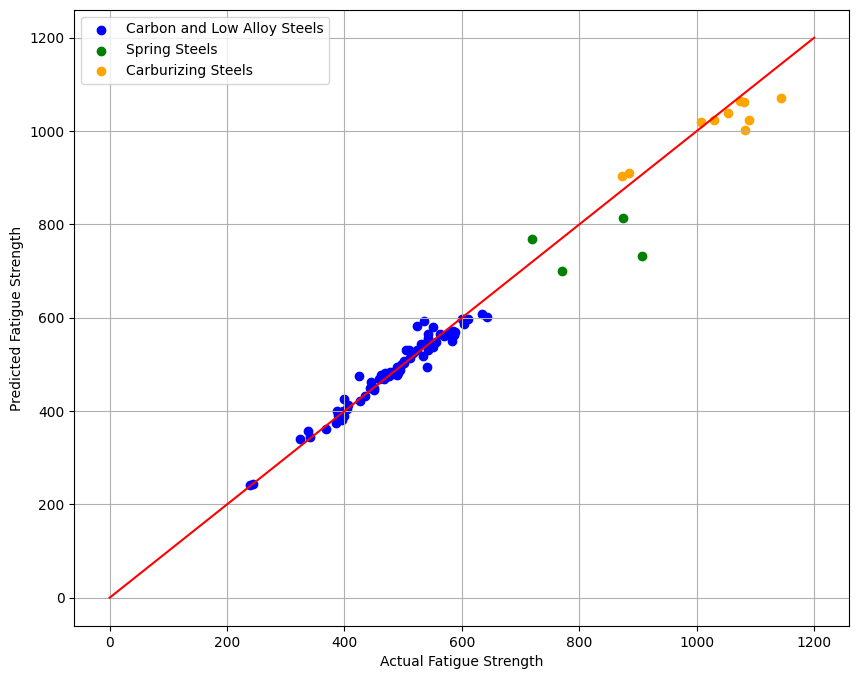

In [93]:
plt.figure(figsize=(10, 8))

for index_range, color, label in [([0, 370], 'blue', 'Carbon and Low Alloy Steels'), 
                                  ([371, 388], 'green', 'Spring Steels'), 
                                  ([389, 436], 'orange', 'Carburizing Steels')]:
    mask = y_test.index.isin(range(index_range[0], index_range[1]+1))
    plt.scatter(y_test[mask], y_pred[mask], color=color, label=label)

plt.xlabel('Actual Fatigue Strength')
plt.ylabel('Predicted Fatigue Strength')
plt.legend()
plt.grid(True)
x = np.linspace(0, 1200, 1000)
plt.plot(x, x, color='red')
plt.show()

In [127]:
model = SVR()
scalar = RobustScaler()
cv = LeaveOneOut()
X_train_scaled = scalar.fit_transform(X_train)
X_test_scaled = scalar.fit_transform(X_test)
# X_train_scaled = X_train
# X_test_scaled = X_test
# model = Pipeline([ ('transformer', scalar), ('estimator', model)])

y_pred_cv = cross_val_predict(model, X_train_scaled, y_train, cv=cv)
r2_cv = r2_score(y_train, y_pred_cv)
print('R^2 CV:', r2_cv)

model.fit(X_train_scaled, y_train)
y_pred = model.predict(X_test_scaled)
r2 = r2_score(y_test, y_pred)
MSE = mean_squared_error(y_test, y_pred)

print('Test R^2 :', r2)
print('Test MSE :', MSE)

R^2 CV: 0.13004341823054055
Test R^2 : 0.10431183509604214
Test MSE : 35446.20248408782


In [25]:
params = {
    'C': [0.1, 1, 10],  
    'kernel': ['rbf', 'linear'],  
    'gamma': ['scale', 'auto'],  
    'epsilon': [0.01, 0.1, 0.5]  
}

cv_model = GridSearchCV(model, params, scoring='neg_mean_squared_error', cv = cv, n_jobs = -1, verbose = 2)
cv_model.fit(X_train_scaled, y_train)

cv_results = cv_model.cv_results_
best_score = -np.max(cv_results['mean_test_score']) 

print("Best case MSE", best_score)
print("Best params:", cv_model.best_params_)


Fitting 348 folds for each of 36 candidates, totalling 12528 fits
Best case MSE 1322.409293701691
Best params: {'C': 10, 'epsilon': 0.01, 'gamma': 'scale', 'kernel': 'linear'}


In [158]:
svm_model_tuned = SVR(C=10,
                      epsilon=0.01,
                      gamma='scale',
                      kernel='linear')
svm_model_tuned.fit(X_train_scaled, y_train)

predictions_RFE = cross_val_predict(svm_model_tuned, X_train, y_train, cv=cv)
r2_RFE = r2_score(y_train, predictions_RFE)
print('R^2 RFE:', r2_RFE)

y_pred = svm_model_tuned.predict(X_test_scaled)
r2_test= r2_score(y_test, y_pred)
MSE_test= mean_squared_error(y_test, y_pred)

print('Test R^2:', r2_test)
print('Test MSE:', MSE_test)



for label, (start_idx, end_idx) in ranges.items():
    mask = y_test.index.isin(range(start_idx, end_idx+1))
    predictions_subset = y_pred[mask]
    actual_subset = y_test[mask]
    r2_subset = mean_squared_error(actual_subset, predictions_subset)
    print(f'MSE for {label}: {r2_subset}')

R^2 RFE: 0.9417106023378111
Test R^2: 0.9269873233674161
Test MSE: 2889.423151082165
MSE for Carbon and Low Alloy Steels: 1028.4030439411881
MSE for Spring Steels: 1647.9497786864545
MSE for Carburizing Steels: 17343.663303597776


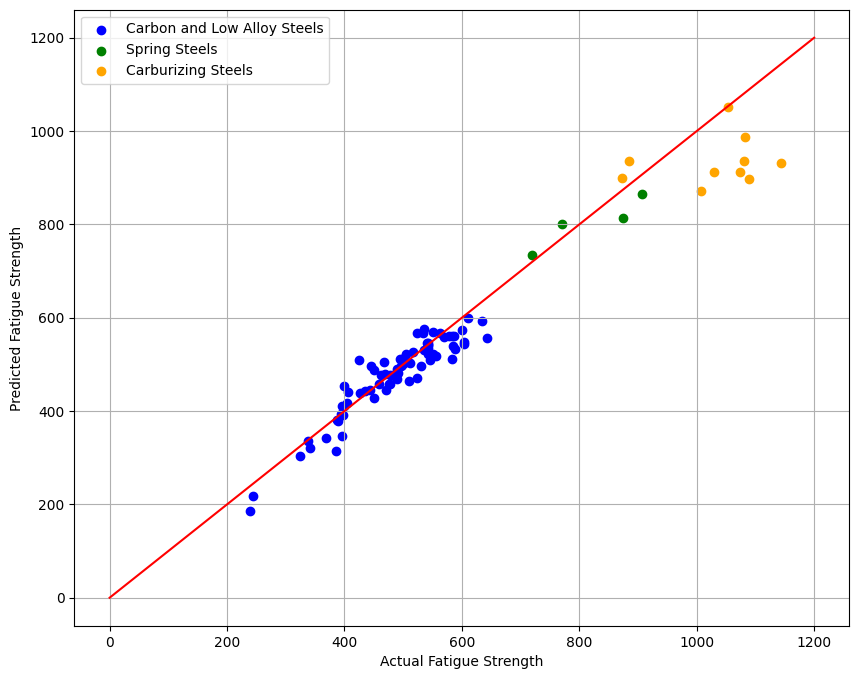

In [159]:
plt.figure(figsize=(10, 8))

for index_range, color, label in [([0, 370], 'blue', 'Carbon and Low Alloy Steels'), 
                                  ([371, 388], 'green', 'Spring Steels'), 
                                  ([389, 436], 'orange', 'Carburizing Steels')]:
    mask = y_test.index.isin(range(index_range[0], index_range[1]+1))
    plt.scatter(y_test[mask], y_pred[mask], color=color, label=label)

plt.xlabel('Actual Fatigue Strength')
plt.ylabel('Predicted Fatigue Strength')
plt.legend()
plt.grid(True)
x = np.linspace(0, 1200, 1000)
plt.plot(x, x, color='red')
plt.show()

In [14]:
from sklearn.neural_network import MLPRegressor

model = MLPRegressor()
scalar = RobustScaler()
cv = LeaveOneOut()
# X_train_scaled = scalar.fit_transform(X_train)
# X_test_scaled = scalar.fit_transform(X_test)
X_train_scaled = X_train
X_test_scaled = X_test
# model = Pipeline([ ('transformer', scalar), ('estimator', model)])

y_pred_cv = cross_val_predict(model, X_train_scaled, y_train, cv=50)
r2_cv = r2_score(y_train, y_pred_cv)
print('R^2 CV:', r2_cv)

model.fit(X_train_scaled, y_train)
y_pred = model.predict(X_test_scaled)
r2 = r2_score(y_test, y_pred)
MSE = mean_squared_error(y_test, y_pred)

print('Test R^2 :', r2)
print('Test MSE :', MSE)

R^2 CV: 0.6245136026621587
Test R^2 : 0.5788682800063227
Test MSE : 16665.97908097702


In [16]:
params = {
    'hidden_layer_sizes': [(50,), (100,), (50, 50)],  
    'activation': ['relu'],  
    'solver': ['adam', 'lbfgs'],  
    'alpha': [0.0001, 0.001, 0.01],  # Regularization 
    'learning_rate_init': [0.001, 0.01]  
}

# Set up GridSearchCV
cv_model = GridSearchCV(model, params, scoring='neg_mean_squared_error', cv=50, n_jobs=-1, verbose=2)
cv_model.fit(X_train, y_train)

# Access and print the results
cv_results = cv_model.cv_results_
best_score = -np.max(cv_results['mean_test_score'])  

print("Best case MSE:", best_score)
print("Best parameters:", cv_model.best_params_)

Fitting 50 folds for each of 36 candidates, totalling 1800 fits
Best case MSE: 2459.035547518564
Best parameters: {'activation': 'relu', 'alpha': 0.001, 'hidden_layer_sizes': (50, 50), 'learning_rate_init': 0.01, 'solver': 'adam'}


In [160]:
MLP_model_tuned = MLPRegressor(activation='relu',
                      alpha=0.001,
                      hidden_layer_sizes=(50, 50),
                      learning_rate_init=0.01,
                      solver='adam')
MLP_model_tuned.fit(X_train, y_train)

predictions_RFE = cross_val_predict(MLP_model_tuned, X_train, y_train, cv=cv)
r2_RFE = r2_score(y_train, predictions_RFE)
print('R^2 RFE:', r2_RFE)

y_pred = MLP_model_tuned.predict(X_test)
r2_test= r2_score(y_test, y_pred)
MSE_test= mean_squared_error(y_test, y_pred)

print('Test R^2:', r2_test)
print('Test MSE:', MSE_test)


for label, (start_idx, end_idx) in ranges.items():
    mask = y_test.index.isin(range(start_idx, end_idx+1))
    predictions_subset = y_pred[mask]
    actual_subset = y_test[mask]
    r2_subset = mean_squared_error(actual_subset, predictions_subset)
    print(f'MSE for {label}: {r2_subset}')

R^2 RFE: 0.9235288064243056
Test R^2: 0.9251072320354347
Test MSE: 2963.826387223105
MSE for Carbon and Low Alloy Steels: 1640.801415156845
MSE for Spring Steels: 10167.069661522302
MSE for Carburizing Steels: 10005.216368000363


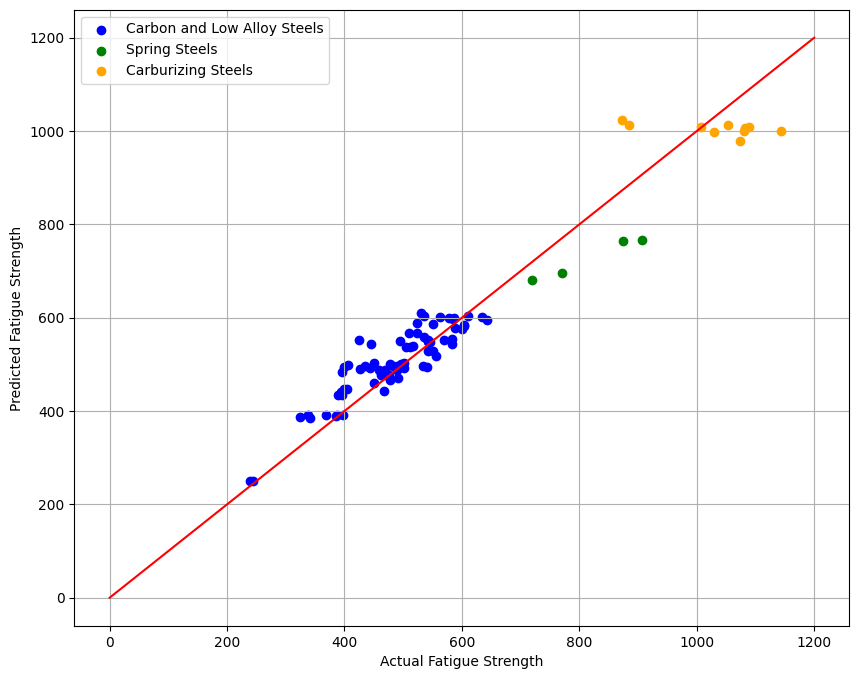

In [19]:
plt.figure(figsize=(10, 8))

for index_range, color, label in [([0, 370], 'blue', 'Carbon and Low Alloy Steels'), 
                                  ([371, 388], 'green', 'Spring Steels'), 
                                  ([389, 436], 'orange', 'Carburizing Steels')]:
    mask = y_test.index.isin(range(index_range[0], index_range[1]+1))
    plt.scatter(y_test[mask], y_pred[mask], color=color, label=label)

plt.xlabel('Actual Fatigue Strength')
plt.ylabel('Predicted Fatigue Strength')
plt.legend()
plt.grid(True)
x = np.linspace(0, 1200, 1000)
plt.plot(x, x, color='red')
plt.show()

In [21]:
from sklearn.linear_model import ElasticNet

model = ElasticNet()
cv = LeaveOneOut()

# model = Pipeline([ ('transformer', scalar), ('estimator', model)])

y_pred_cv = cross_val_predict(model, X_train, y_train, cv=cv)
r2_cv = r2_score(y_train, y_pred_cv)
print('R^2 CV:', r2_cv)

model.fit(X_train, y_train)
y_pred = model.predict(X_test)
r2 = r2_score(y_test, y_pred)
MSE = mean_squared_error(y_test, y_pred)

print('Test R^2 :', r2)
print('Test MSE :', MSE)

R^2 CV: 0.91604270138184
Test R^2 : 0.8951543361934156
Test MSE : 4149.190281268577


In [22]:
params = {
    'alpha': [0.1, 0.5, 1, 2], 
    'l1_ratio': [0.1, 0.5, 0.9],  
    'max_iter': [1000, 5000],  
    'tol': [0.0001, 0.001]  
}

cv_model = GridSearchCV(model, params, scoring='neg_mean_squared_error', cv=cv, n_jobs=-1, verbose=2)
cv_model.fit(X_train, y_train)

cv_results = cv_model.cv_results_
best_score = -np.max(cv_results['mean_test_score'])  
print("Best case MSE:", best_score)
print("Best parameters:", cv_model.best_params_)

Fitting 348 folds for each of 48 candidates, totalling 16704 fits
Best case MSE: 1807.1879425059633
Best parameters: {'alpha': 0.1, 'l1_ratio': 0.9, 'max_iter': 5000, 'tol': 0.0001}


In [161]:
elastic_model_tuned = ElasticNet(l1_ratio=0.9,
                      alpha=0.01,
                      tol=0.0001,
                      max_iter=5000
                      )
elastic_model_tuned.fit(X_train, y_train)

predictions_RFE = cross_val_predict(elastic_model_tuned, X_train, y_train, cv=cv)
r2_RFE = r2_score(y_train, predictions_RFE)
print('R^2 RFE:', r2_RFE)

y_pred = elastic_model_tuned.predict(X_test)
r2_test= r2_score(y_test, y_pred)
MSE_test= mean_squared_error(y_test, y_pred)

print('Test R^2:', r2_test)
print('Test MSE:', MSE_test)

for label, (start_idx, end_idx) in ranges.items():
    mask = y_test.index.isin(range(start_idx, end_idx+1))
    predictions_subset = y_pred[mask]
    actual_subset = y_test[mask]
    r2_subset = mean_squared_error(actual_subset, predictions_subset)
    print(f'MSE for {label}: {r2_subset}')

R^2 RFE: 0.9607225741764714
Test R^2: 0.955356145511482
Test MSE: 1766.7478123257824
MSE for Carbon and Low Alloy Steels: 609.5405214550137
MSE for Spring Steels: 7961.562021729569
MSE for Carburizing Steels: 7967.876810095035


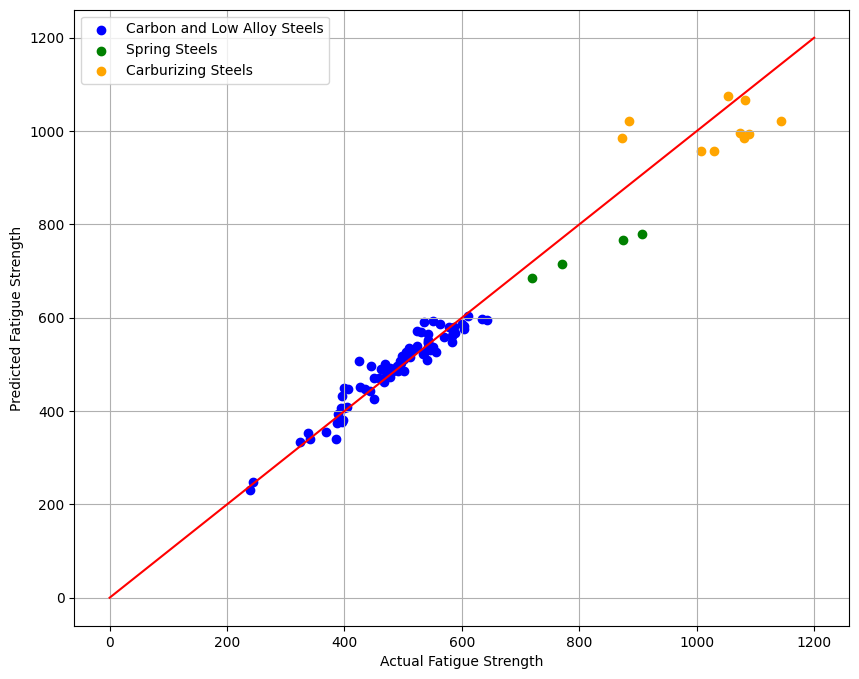

In [24]:
plt.figure(figsize=(10, 8))

for index_range, color, label in [([0, 370], 'blue', 'Carbon and Low Alloy Steels'), 
                                  ([371, 388], 'green', 'Spring Steels'), 
                                  ([389, 436], 'orange', 'Carburizing Steels')]:
    mask = y_test.index.isin(range(index_range[0], index_range[1]+1))
    plt.scatter(y_test[mask], y_pred[mask], color=color, label=label)

plt.xlabel('Actual Fatigue Strength')
plt.ylabel('Predicted Fatigue Strength')
plt.legend()
plt.grid(True)
x = np.linspace(0, 1200, 1000)
plt.plot(x, x, color='red')
plt.show()

In [32]:
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RBF, Matern, RationalQuadratic, ExpSineSquared

model = GaussianProcessRegressor()
cv = LeaveOneOut()

# model = Pipeline([ ('transformer', scalar), ('estimator', model)])

y_pred_cv = cross_val_predict(model, X_train, y_train, cv=cv)
r2_cv = r2_score(y_train, y_pred_cv)
print('R^2 CV:', r2_cv)

model.fit(X_train, y_train)
y_pred = model.predict(X_test)
r2 = r2_score(y_test, y_pred)
MSE = mean_squared_error(y_test, y_pred)

print('Test R^2 :', r2)
print('Test MSE :', MSE)

R^2 CV: -0.8911602723174337
Test R^2 : 0.7746424873950843
Test MSE : 8918.358348478068


In [33]:
params = {
    'kernel': [
        1.0 * RBF(length_scale=1.0),
        1.0 * RBF(length_scale=2.0),
        1.0 * Matern(length_scale=1.0, nu=1.5),
        1.0 * RationalQuadratic(length_scale=1.0, alpha=0.1)
    ],
    'alpha': [1e-10, 1e-2],
    'n_restarts_optimizer': [0, 1, 2]
}

cv_model = GridSearchCV(model, params, scoring='neg_mean_squared_error', cv=cv, n_jobs=-1, verbose=2)
cv_model.fit(X_train, y_train)

# Access and print the results
cv_results = cv_model.cv_results_
best_score = -np.max(cv_results['mean_test_score'])  

print("Best case MSE:", best_score)
print("Best parameters:", cv_model.best_params_)

Fitting 348 folds for each of 24 candidates, totalling 8352 fits
Best case MSE: 2220.268172630337
Best parameters: {'alpha': 1e-10, 'kernel': 1**2 * RationalQuadratic(alpha=0.1, length_scale=1), 'n_restarts_optimizer': 2}


In [162]:
GPR_model_tuned = GaussianProcessRegressor(kernel=1**2 * RationalQuadratic(alpha=0.1, length_scale=1),
                      alpha=1e-10,
                      n_restarts_optimizer=2,
                      )
GPR_model_tuned.fit(X_train, y_train)

predictions_RFE = cross_val_predict(GPR_model_tuned, X_train, y_train, cv=cv)
r2_RFE = r2_score(y_train, predictions_RFE)
print('R^2 RFE:', r2_RFE)

y_pred = GPR_model_tuned.predict(X_test)
r2_test= r2_score(y_test, y_pred)
MSE_test= mean_squared_error(y_test, y_pred)

print('Test R^2:', r2_test)
print('Test MSE:', MSE_test)


for label, (start_idx, end_idx) in ranges.items():
    mask = y_test.index.isin(range(start_idx, end_idx+1))
    predictions_subset = y_pred[mask]
    actual_subset = y_test[mask]
    r2_subset = mean_squared_error(actual_subset, predictions_subset)
    print(f'MSE for {label}: {r2_subset}')

R^2 RFE: 0.9338253087071441
Test R^2: 0.9372010625764939
Test MSE: 2485.2219097232814
MSE for Carbon and Low Alloy Steels: 561.1413359296726
MSE for Spring Steels: 11647.141062880704
MSE for Carburizing Steels: 13251.058551912376


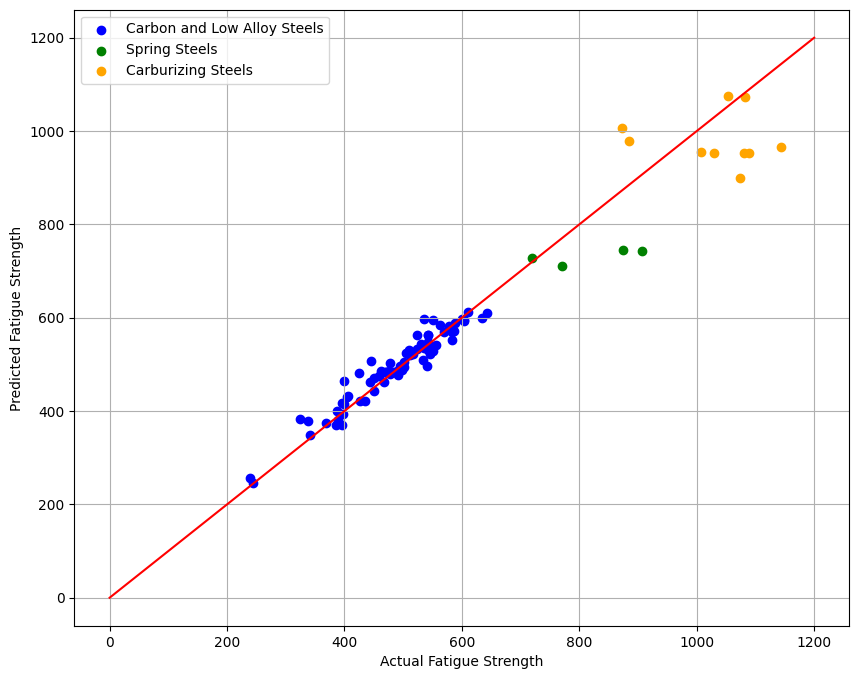

In [35]:
plt.figure(figsize=(10, 8))

for index_range, color, label in [([0, 370], 'blue', 'Carbon and Low Alloy Steels'), 
                                  ([371, 388], 'green', 'Spring Steels'), 
                                  ([389, 436], 'orange', 'Carburizing Steels')]:
    mask = y_test.index.isin(range(index_range[0], index_range[1]+1))
    plt.scatter(y_test[mask], y_pred[mask], color=color, label=label)

plt.xlabel('Actual Fatigue Strength')
plt.ylabel('Predicted Fatigue Strength')
plt.legend()
plt.grid(True)
x = np.linspace(0, 1200, 1000)
plt.plot(x, x, color='red')
plt.show()

In [39]:
from sklearn.linear_model import RANSACRegressor

model = RANSACRegressor()

scalar = RobustScaler()
cv = LeaveOneOut()
X_train_scaled = scalar.fit_transform(X_train)
X_test_scaled = scalar.fit_transform(X_test)
# X_train_scaled = X_train
# X_test_scaled = X_test
# model = Pipeline([ ('transformer', scalar), ('estimator', model)])

y_pred_cv = cross_val_predict(model, X_train_scaled, y_train, cv=50)
r2_cv = r2_score(y_train, y_pred_cv)
print('R^2 CV:', r2_cv)

model.fit(X_train_scaled, y_train)
y_pred = model.predict(X_test_scaled)
r2 = r2_score(y_test, y_pred)
MSE = mean_squared_error(y_test, y_pred)

print('Test R^2 :', r2)
print('Test MSE :', MSE)

R^2 CV: 0.8091270194593948
Test R^2 : 0.6863424382917427
Test MSE : 12412.76805769596


In [42]:
params = {
    'min_samples': [None, 50, 100],  
    'max_trials': [50, 100, 200],  
    'loss': ['absolute_error', 'squared_error'],  
    'residual_threshold': [None, 5, 10]  
}

cv_model = GridSearchCV(model, params, scoring='neg_mean_squared_error', cv=cv, n_jobs=-1, verbose=2)
cv_model.fit(X_train_scaled, y_train)

cv_results = cv_model.cv_results_
best_score = -np.max(cv_results['mean_test_score'])  
print("Best case MSE:", best_score)
print("Best parameters:", cv_model.best_params_)

Fitting 348 folds for each of 54 candidates, totalling 18792 fits
Best case MSE: 1274.3874273683366
Best parameters: {'loss': 'absolute_error', 'max_trials': 200, 'min_samples': 100, 'residual_threshold': None}


In [163]:
RANSAC_model_tuned = RANSACRegressor(loss='absolute_error',
                                     max_trials=200,
                                     min_samples=100,
                                     residual_threshold=None
                                    )
RANSAC_model_tuned.fit(X_train_scaled, y_train)

predictions_RFE = cross_val_predict(RANSAC_model_tuned, X_train, y_train, cv=cv)
r2_RFE = r2_score(y_train, predictions_RFE)
print('R^2 RFE:', r2_RFE)

y_pred = RANSAC_model_tuned.predict(X_test_scaled)
r2_test= r2_score(y_test, y_pred)
MSE_test= mean_squared_error(y_test, y_pred)

print('Test R^2:', r2_test)
print('Test MSE:', MSE_test)


for label, (start_idx, end_idx) in ranges.items():
    mask = y_test.index.isin(range(start_idx, end_idx+1))
    predictions_subset = y_pred[mask]
    actual_subset = y_test[mask]
    r2_subset = mean_squared_error(actual_subset, predictions_subset)
    print(f'MSE for {label}: {r2_subset}')

R^2 RFE: 0.957491431376417
Test R^2: 0.9344743753203197
Test MSE: 2593.128558912396
MSE for Carbon and Low Alloy Steels: 1004.2991008142434
MSE for Spring Steels: 3817.0261745842654
MSE for Carburizing Steels: 14019.790448379794


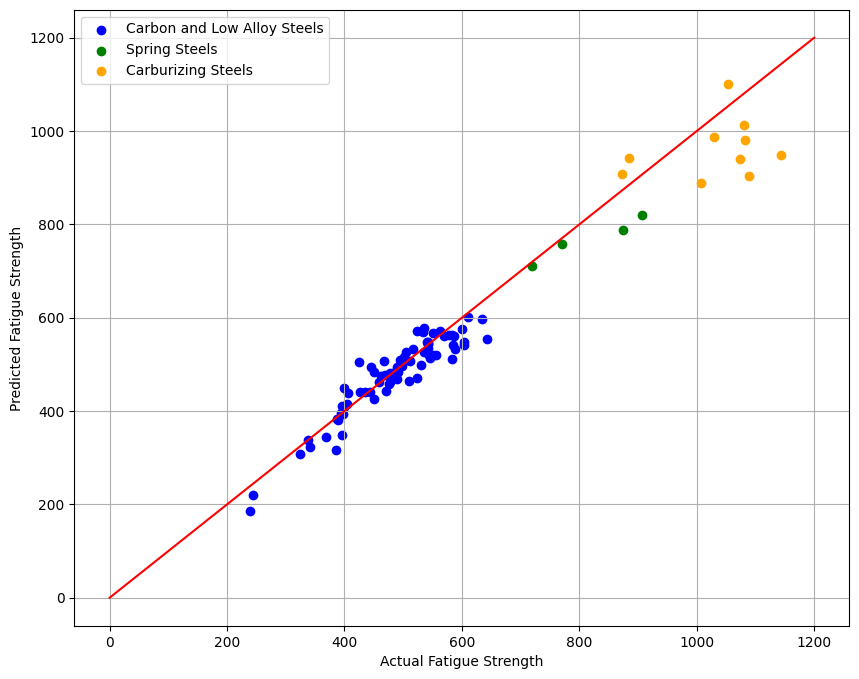

In [46]:
plt.figure(figsize=(10, 8))

for index_range, color, label in [([0, 370], 'blue', 'Carbon and Low Alloy Steels'), 
                                  ([371, 388], 'green', 'Spring Steels'), 
                                  ([389, 436], 'orange', 'Carburizing Steels')]:
    mask = y_test.index.isin(range(index_range[0], index_range[1]+1))
    plt.scatter(y_test[mask], y_pred[mask], color=color, label=label)

plt.xlabel('Actual Fatigue Strength')
plt.ylabel('Predicted Fatigue Strength')
plt.legend()
plt.grid(True)
x = np.linspace(0, 1200, 1000)
plt.plot(x, x, color='red')
plt.show()

Test R^2: 0.9744612925057089
Test MSE: 1010.675626289648
MSE for Carbon and Low Alloy Steels: 350.27748131876507
MSE for Spring Steels: 8381.65923993698
MSE for Carburizing Steels: 3015.2682681123365


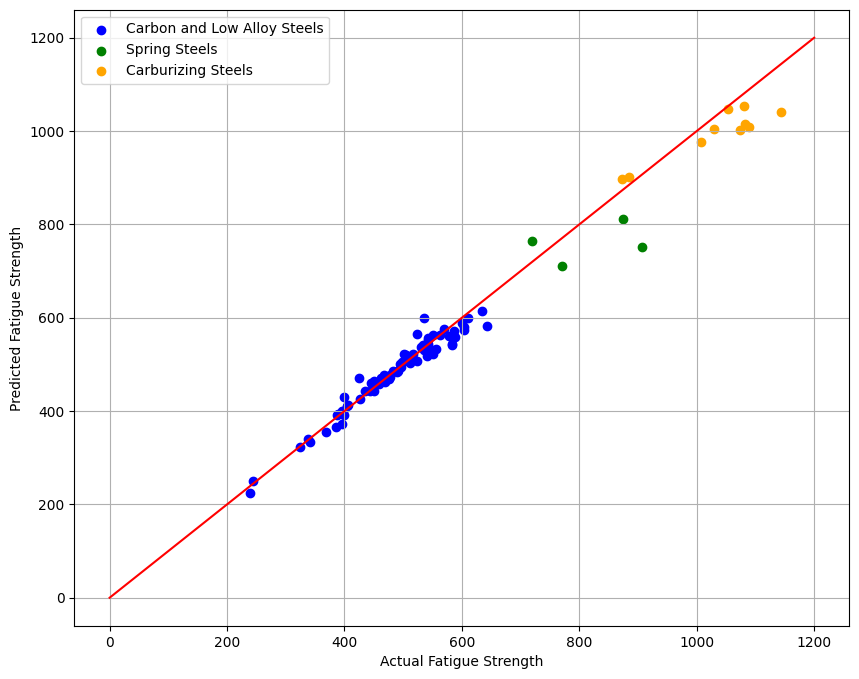

In [137]:
predictions_svm = svm_model_tuned.predict(X_test_scaled)
predictions_catboost = cat_model_tuned.predict(X_test)
predictions_xgb = xgb_model_tuned.predict(X_test)

# Simple average
final_predictions = (predictions_svm + 2* predictions_xgb) / 3 # + predictions_catboost
r2_test= r2_score(y_test, final_predictions)
MSE_test= mean_squared_error(y_test, final_predictions)

print('Test R^2:', r2_test)
print('Test MSE:', MSE_test)


for label, (start_idx, end_idx) in ranges.items():
    mask = y_test.index.isin(range(start_idx, end_idx+1))
    predictions_subset = final_predictions[mask]
    actual_subset = y_test[mask]
    r2_subset = mean_squared_error(actual_subset, predictions_subset)
    print(f'MSE for {label}: {r2_subset}')

plt.figure(figsize=(10, 8))

for index_range, color, label in [([0, 370], 'blue', 'Carbon and Low Alloy Steels'), 
                                  ([371, 388], 'green', 'Spring Steels'), 
                                  ([389, 436], 'orange', 'Carburizing Steels')]:
    mask = y_test.index.isin(range(index_range[0], index_range[1]+1))
    plt.scatter(y_test[mask], final_predictions[mask], color=color, label=label)

plt.xlabel('Actual Fatigue Strength')
plt.ylabel('Predicted Fatigue Strength')
plt.legend()
plt.grid(True)
x = np.linspace(0, 1200, 1000)
plt.plot(x, x, color='red')
plt.show()

In [235]:
from sklearn.ensemble import StackingRegressor

svm_pipeline = Pipeline([
    ('scaler', RobustScaler()),
    ('svm', svm_model_tuned)
])

estimators = [
    ('svm', svm_pipeline),
    # ('catboost', cat_model_tuned),  # Assuming CatBoostRegressor has been imported and is ready to use
    ('xgb', xgb_model_tuned),
    # ('ransac', RANSAC_model_tuned)
    # ('ransac', LGBM_model_tuned)  
]

# final_estimator = XGBRegressor(booster='gblinear')
final_estimator = KNeighborsRegressor(n_neighbors=5)

stack = StackingRegressor(
    estimators=estimators,
    final_estimator=final_estimator,
    cv=cv,  
    n_jobs=-1,  
    verbose=1  
)

stack.fit(X_train, y_train)

print("Training score: ", stack.score(X_train, y_train))
print("Test score: ", stack.score(X_test, y_test))


Training score:  0.9924222222655726
Test score:  0.9818022592995909


Training score:  0.9924222222655726
Test R^2: 0.9818022592995909
Test MSE: 720.162247191011
MSE for Carbon and Low Alloy Steels: 348.9210666666668
MSE for Spring Steels: 6860.3499999999985
MSE for Carburizing Steels: 1048.395999999998


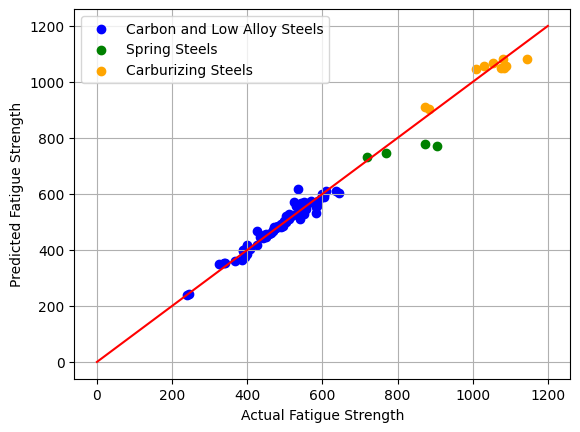

In [236]:
print("Training score: ", stack.score(X_train, y_train))
final_predictions = stack.predict(X_test)

r2_test= r2_score(y_test, final_predictions)
MSE_test= mean_squared_error(y_test, final_predictions)

print('Test R^2:', r2_test)
print('Test MSE:', MSE_test)


for label, (start_idx, end_idx) in ranges.items():
    mask = y_test.index.isin(range(start_idx, end_idx+1))
    predictions_subset = final_predictions[mask]
    actual_subset = y_test[mask]
    r2_subset = mean_squared_error(actual_subset, predictions_subset)
    print(f'MSE for {label}: {r2_subset}')

for index_range, color, label in [([0, 370], 'blue', 'Carbon and Low Alloy Steels'), 
                                  ([371, 388], 'green', 'Spring Steels'), 
                                  ([389, 436], 'orange', 'Carburizing Steels')]:
    mask = y_test.index.isin(range(index_range[0], index_range[1]+1))
    plt.scatter(y_test[mask], final_predictions[mask], color=color, label=label)

plt.xlabel('Actual Fatigue Strength')
plt.ylabel('Predicted Fatigue Strength')
plt.legend()
plt.grid(True)
x = np.linspace(0, 1200, 1000)
plt.plot(x, x, color='red')
plt.show()

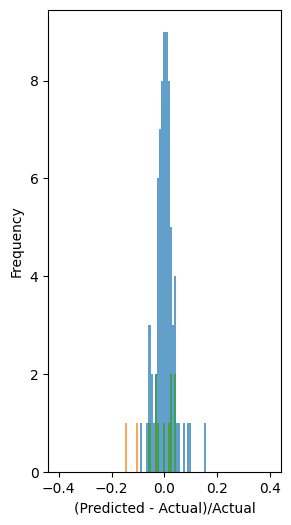

In [232]:

bins = np.linspace(-0.4, 0.4, 100)

plt.figure(figsize=(3, 6))

for label, (start_idx, end_idx) in ranges.items():
    mask = y_test.index.isin(range(start_idx, end_idx+1))
    error_fractions_subset = (final_predictions[mask] - y_test[mask]) / y_test[mask]
    plt.hist(error_fractions_subset, bins=bins, label=label, alpha=0.7)

plt.xlabel('(Predicted - Actual)/Actual')
plt.ylabel('Frequency')
# plt.grid(True)
# plt.legend()
plt.show()